# Altair election maps example

By [Ben Welsh](https://palewi.re/who-is-ben-welsh)

An experiment in creating precinct-level election results maps using [Python's Altair library](https://altair-viz.github.io). Data are drawn from the LA's Measure EE, a proposed parcel tax aimed at funding local schools that [failed in a June 2019 vote](https://www.latimes.com/opinion/editorials/la-ed-measure-ee-lausd-fails-20190606-story.html).

### Import Python tools

In [1]:
import json
import jenkspy
import pandas as pd
import altair as alt
import geopandas as gpd
import altair_latimes as lat

In [2]:
alt.data_transformers.enable('json')

DataTransformerRegistry.enable('json')

In [3]:
alt.themes.register('latimes', lat.theme)
alt.themes.enable('latimes')

ThemeRegistry.enable('latimes')

In [4]:
%matplotlib inline

### Read in the precincts map

This file was acquired from the Los Angeles County Registrar/Recorder's office via a California Public Records Act request.

In [5]:
precincts = gpd.read_file("./data/June_4th_2019.shp")

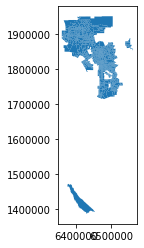

In [6]:
precincts.plot()

### Read in the precinct results

This file was refined from the statement of votes cast published on the Los Angeles County Registrar/Recorder's website.

In [7]:
results = pd.read_csv("./data/LAUSD_SPECIAL-_MEASURE_EE_06-04-19_by_Precinct_4041-5928.csv")

In [8]:
results.head()

,LOCATION,PRECINCT,SERIAL,BALLOT GROUP,VOTE BY MAIL ONLY,REGISTRATION,TYPE,BALLOTS CAST,YES,NO,PASSED,YES_PERCENT
0,BEVERLY HILLS,0900001B,6014,8,Y,0,TOTAL,0,0,0,False,NaN
1,BEVERLY HILLS,0900004C,6015,8,Y,0,TOTAL,0,0,0,False,NaN
2,BEVERLY HILLS,0900004D,6016,8,Y,0,TOTAL,0,0,0,False,NaN
3,COMMERCE,1430035B,6019,8,Y,2,TOTAL,0,0,0,False,NaN
4,CULVER CITY,1600001B,6021,8,Y,0,TOTAL,0,0,0,False,NaN


### Merge the two data sets

In [9]:
merged = precincts.merge(
    results[['PRECINCT', "BALLOTS CAST", "YES", "NO"]],
    left_on="Label",
    right_on="PRECINCT"
)

### Clean up the dataframe

In [10]:
trimmed = merged[[
    'PRECINCT',
    'BALLOTS CAST',
    'YES',
    'NO',
    'geometry'
]].rename(columns={
    "PRECINCT": "precinct",
    "BALLOTS CAST": "ballots_cast",
    "YES": "yes",
    "NO": "no",
})

In [11]:
trimmed.head()

,precinct,ballots_cast,yes,no,geometry
0,2500024A,215,101,114,"POLYGON ((6473178.000046372 1786817.000000089,..."
1,3850002E,0,0,0,"POLYGON ((6499256.999947384 1760227.000014007,..."
2,9002531A,101,67,33,"POLYGON ((6478602.0000294 1802688.999986321, 6..."
3,9002454A,103,53,47,"POLYGON ((6471991.999969646 1827330.00006865, ..."
4,2850025A,178,87,89,"POLYGON ((6499614.000016347 1809236.999960586,..."


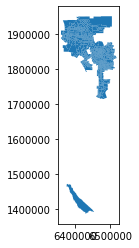

In [12]:
trimmed.plot()

### Cut the island

In [13]:
filtered = trimmed[trimmed.precinct != '5960001A']

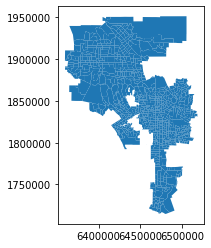

In [14]:
filtered.plot()

### Change the projection

In [15]:
filtered.crs

{'init': 'epsg:2229'}

Let's go with the basic web Mercator you typically find in GeoJSON.

In [16]:
transformed = filtered.to_crs(epsg=4326)

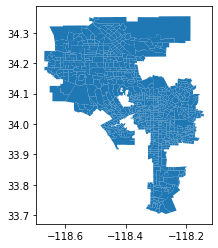

In [17]:
transformed.plot()

### Set breaks

In [18]:
breaks = jenkspy.jenks_breaks(list(transformed.yes) + list(transformed.no), nb_class=7)

In [19]:
breaks

[0.0, 74.0, 138.0, 207.0, 287.0, 398.0, 575.0, 1036.0]

In [20]:
def get_group(value):
    for i, b in enumerate(breaks):
        if value <= breaks[i+1]:
            return i

In [21]:
transformed['yes_group'] = transformed.yes.apply(get_group) 

In [22]:
transformed['no_group'] = transformed.no.apply(get_group) 

# Calculate which side won each precinct

In [23]:
transformed['total_votes'] = transformed.yes + transformed.no

In [24]:
transformed['yes_percent'] = transformed.yes / transformed.total_votes

In [26]:
transformed['passed'] = transformed.yes_percent > 2/3

In [31]:
transformed.passed.value_counts(percent=True).reset_index()

TypeError: value_counts() got an unexpected keyword argument 'percent'

### Write to GeoJSON

In [55]:
transformed.to_file("./data/measure-ee-precincts.geojson", driver="GeoJSON")

### Plot the vote

For some reason, I think we have to feed GeoJSON to Altair. If there's a way to pass in the GeoDataFrame directly, I don't know it.

In [56]:
geojson = json.loads(transformed.to_json())

In [57]:
features = alt.Data(values=geojson['features'])

Make the base map

In [58]:
base = alt.Chart(features).mark_geoshape(
    stroke='black',
    strokeWidth=0.1
).encode().properties(
    width=600,
    height=800
)

Make the fill layers

In [59]:
geoshape = alt.Chart(features).mark_geoshape(
    fill='lightgray',
    stroke='black'
)

In [60]:
yes = geoshape.encode(
    color=alt.Color(
        "properties.yes_group:N",
        scale=alt.Scale(
            domain=[0, 1, 2, 3, 4, 5, 6],
            range=lat.palette['schemes']['ice-7']
        ),
        legend=None
    ),
)

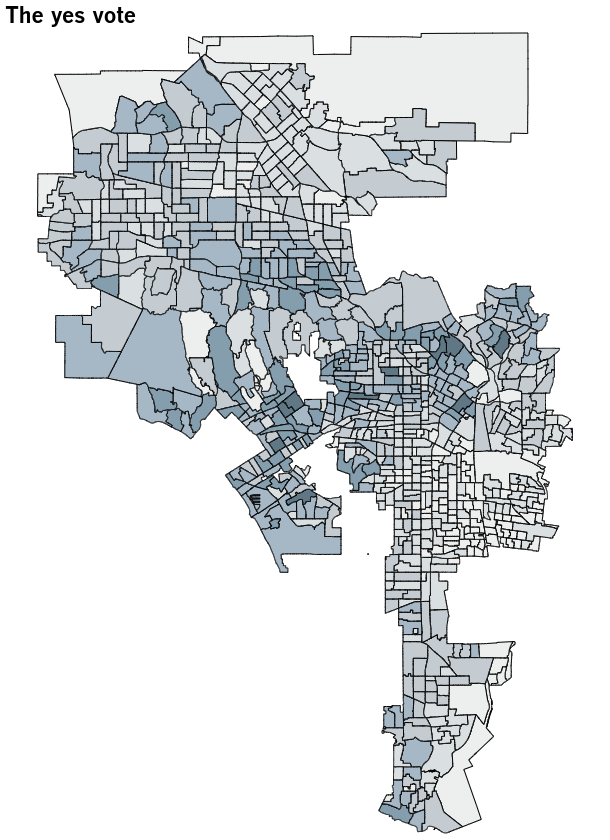

In [61]:
(base + yes).properties(title="The yes vote").configure_view(
    strokeWidth=0
)

In [62]:
no = geoshape.encode(
    color=alt.Color(
        "properties.no_group:N",
        scale=alt.Scale(
            domain=[0, 1, 2, 3, 4, 5, 6],
            range=lat.palette['schemes']['fire-7']
        ),
        legend=None
    )
)

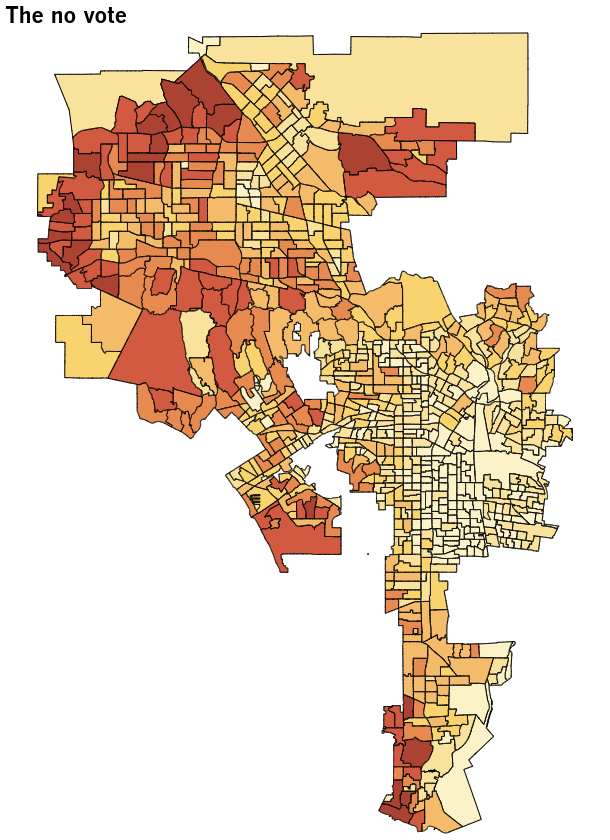

In [63]:
(base + no).properties(title="The no vote").configure_view(
    strokeWidth=0
)